In [1]:
import cv2
import glob
from matplotlib.collections import PatchCollection
from matplotlib.patches import Polygon
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import subprocess
import sys
%matplotlib inline

In [2]:
# repeat for actual images
anchors = pd.read_csv('points.csv', delimiter=';').set_index('fname')
npts = anchors.shape[1] // 2

f0, f1 = ['images/IMG_%04d.jpeg' % i for i in (919, 1015)]
z0, z1 = cv2.imread(f0), cv2.imread(f1)
h, w, _ = z0.shape

pt0 = anchors.loc[f0].values.reshape((npts, 2))
pt1 = anchors.loc[f1].values.reshape((npts, 2))


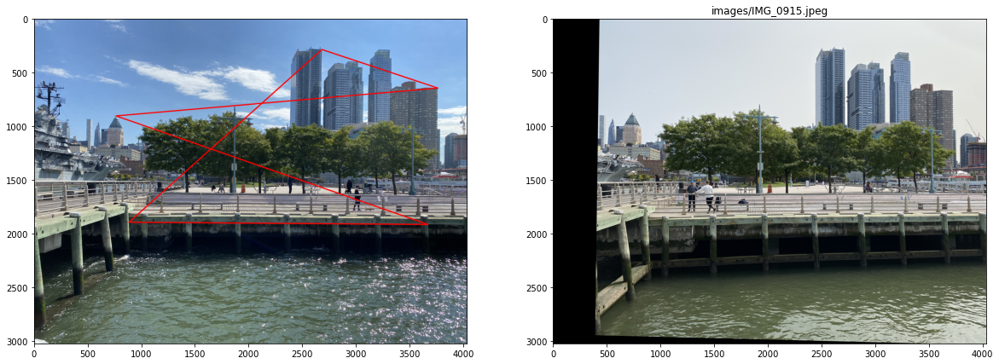

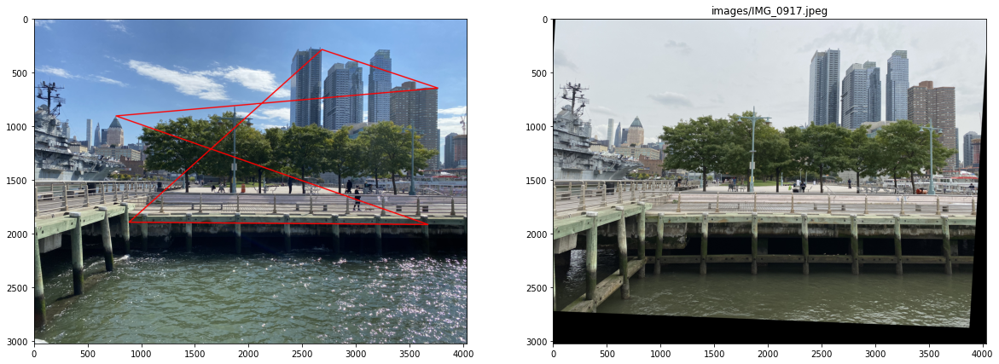

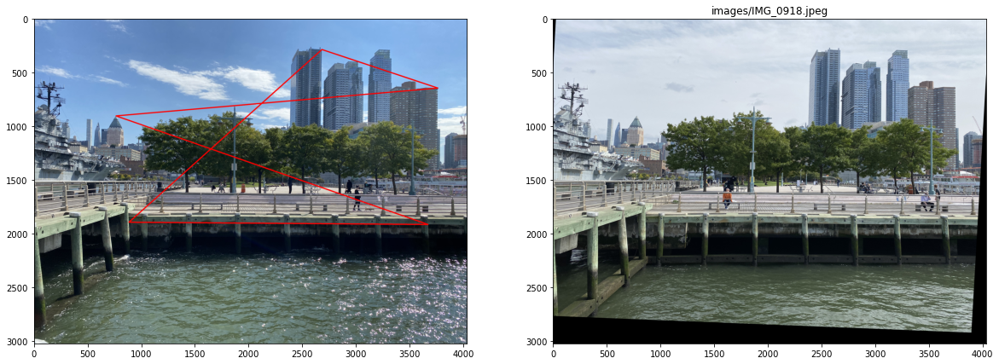

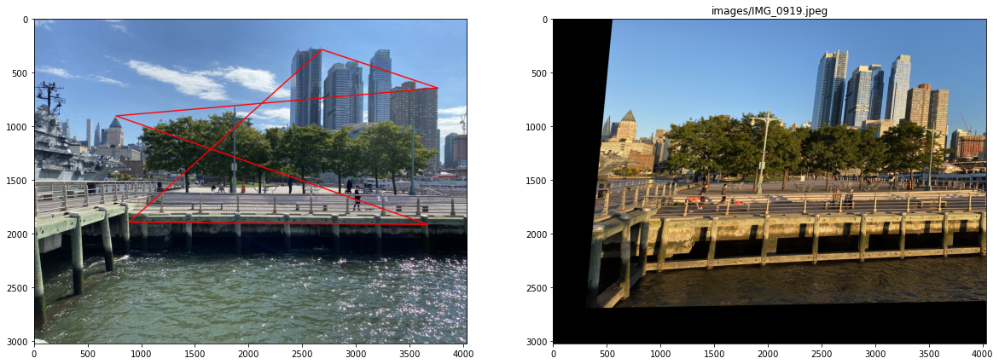

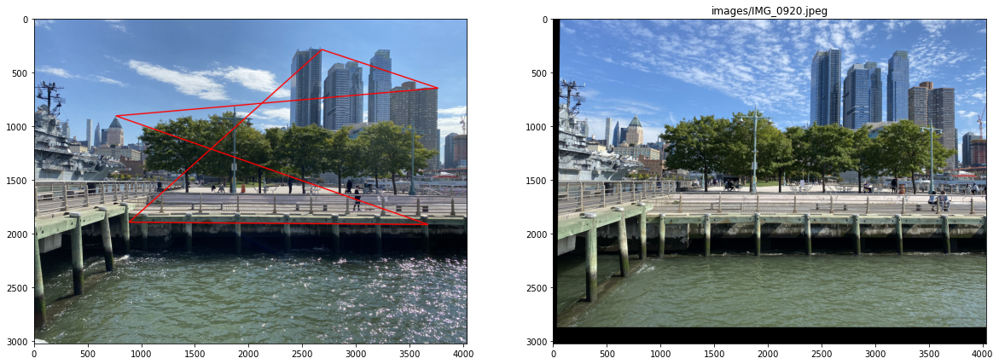

...

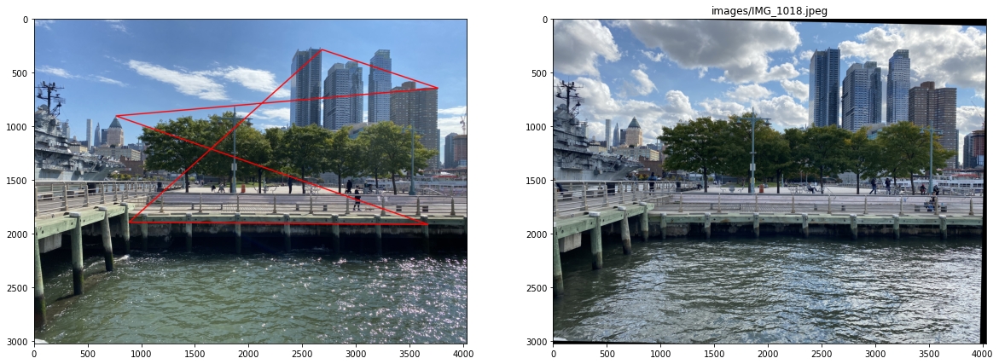

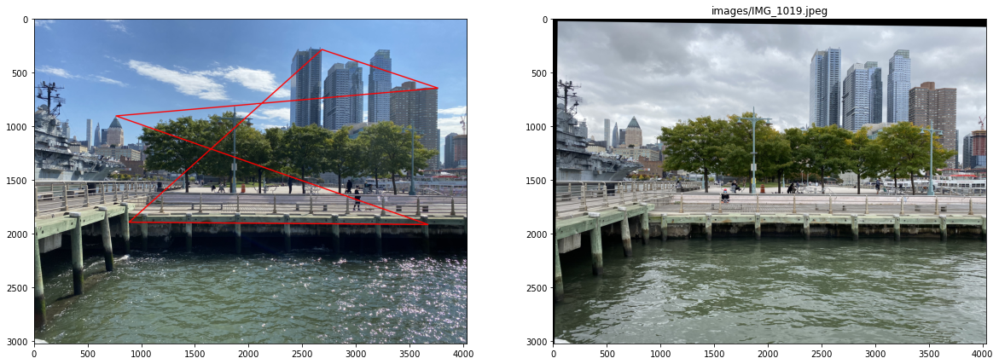

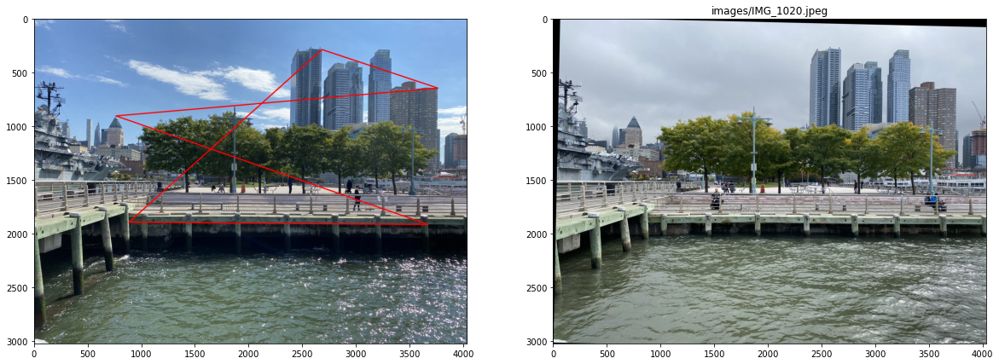

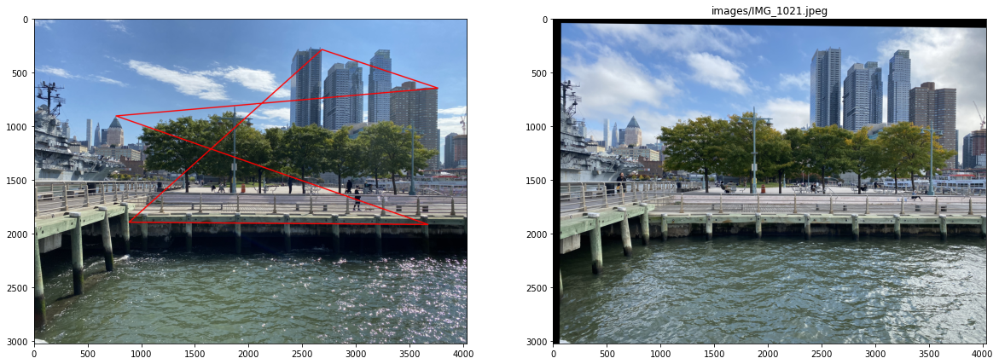

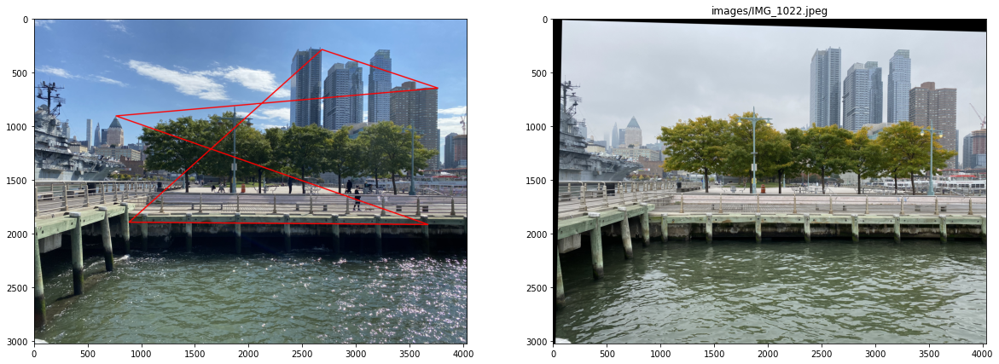

In [3]:
# repeat for all images
anchors = pd.read_csv('points.csv', delimiter=';').set_index('fname')

# index image
f0 = 'images/IMG_1001.jpeg'
z0 = cv2.imread(f0)
h, w, _ = z0.shape
pt0 = anchors.loc[f0].values.reshape((npts, 2))

pts = np.array(np.c_[pt0[:, 0], h - pt0[:, 1]].tolist(), np.int32)
pts_0 = pts.reshape((-1, 1, 2))
zt0 = cv2.polylines(z0, [pts_0], True, (0, 0, 255), thickness=10)
m0 = np.c_[pts_0[:, 0], np.ones(npts)]

z_all = []
zw_all = []

plot = True

for f1 in sorted(glob.glob('images/*.jpeg')):

    z1 = cv2.imread(f1)
    z_all.append(z1)
    
    pt1 = anchors.loc[f1].values.reshape((npts, 2))

    pts = np.array(np.c_[pt1[:, 0], h - pt1[:, 1]].tolist(), np.int32)
    pts_1 = pts.reshape((-1, 1, 2))
    #zt1 = cv2.polylines(z1, [pts_1], True, (0, 0, 255), thickness=10)

    # compute transformation
    
    m1 = np.c_[pts_1[:, 0], np.ones(npts)]
    M = np.linalg.pinv(m1) @ m0
    zW = cv2.warpAffine(z1, M[:, :2].T.astype('float32'), (w, h))
    zw_all.append(zW)
    
    if plot:
        fig, ax = plt.subplots(1, 2, figsize=(20, 7))
        ax[0].imshow(zt0[:, :, ::-1])
        ax[1].set_title(f1)
        ax[1].imshow(zW[:, :, ::-1])
        plt.show()

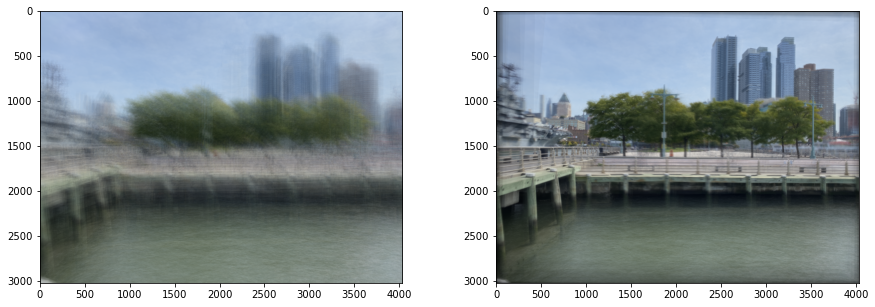

In [4]:
if plot:
    Z = np.array(z_all).astype(float).mean(0).astype('uint8')[:, :, ::-1]
    Zw = np.array(zw_all).astype(float).mean(0).astype('uint8')[:, :, ::-1]

    fig, ax = plt.subplots(1, 2, figsize=(15, 5))
    ax[0].imshow(Z)
    ax[1].imshow(Zw)
    plt.show()

In [5]:
subprocess.call('rm autumn.gif', shell=True)

scale = 4
i = 1

for z in zw_all[:3] + zw_all[4:]:
    z = z[100:-500, 500:-200]
    h, w, _ = z.shape
    z = cv2.resize(z, (w // scale, h // scale))
    
    z = cv2.putText(z, '%d' % i, (50, 50), cv2.FONT_HERSHEY_SIMPLEX,  
                   1, (255, 255, 255), 2, cv2.LINE_AA)
    
    outfile = 'tmp_%03d.jpeg' % i
    cv2.imwrite(outfile, z)
    
    
    i += 1

cmd = 'convert -delay 1x5 `seq -f tmp_%%03g.jpeg 1 1 %d` -coalesce -duplicate 1,-2-1 -loop 0 autumn.gif' % (i-1)
subprocess.call(cmd, shell=True)
subprocess.call('rm tmp*.jpeg', shell=True)

0

In [40]:
p0 = pts_0[:4, 0].astype('float32')
p1 = pts_1[:4, 0].astype('float32')

m = cv2.getPerspectiveTransform(p1, p0)
zw = cv2.warpPerspective(z1, m, (z0.shape[1], z0.shape[0]))
zz = ((zw.astype('float') + z0.astype('float'))/2).astype('uint8')

fig, ax = plt.subplots(figsize=(7, 7))
ax.imshow(zz[:, :, ::-1])
plt.show()